# EXPLORATORY DATA ANALYSIS ON RETAIL DATASET
#### Applying EDA on the sales data of a fictitious company to discover the transactional patterns and gain insights which can help the sales and marketing teams in business decision making. 


##### Import the necessary libraries

In [42]:
# import the needed libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots
from datetime import datetime
import warnings
warnings.filterwarnings('ignore')



In [43]:
# Import wordcloud
### Word Cloud
from PIL import Image
!pip install wordcloud
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

In [44]:
# this is used to show the current working directory
import os

In [45]:
# show the current working directory
os.getcwd()

'C:\\Users\\Jeremy\\Documents\\My portfolio projects\\Python Project\\Sales'

In [46]:
#read the data 
sales_df = pd.read_csv("C:\\Users\\Jeremy\\Documents\\My portfolio projects\\Python Project\\Sales\\sales_data.csv")




### Overview the Data: A sneak peak into the data

#### View the 1st 5 rows and the last 5 rows of the data using the .head() and .tail() methods

In [47]:
#.head() returns only the 1st 5 rows of the dataframe
sales_df.head()

,Date,Customer_Age,Age_Group,Customer_Gender,Country,State,Product_Category,Sub_Category,Product,Order_Quantity,Unit_Cost,Unit_Price,Cost
0,26/11/2013,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,360
1,26/11/2015,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,360
2,23/03/2014,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,23,45,120,1035
3,23/03/2016,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,20,45,120,900
4,15/05/2014,47,Adults (35-64),F,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,4,45,120,180


In [48]:
#.tail returns the last 5 of the dataframe
sales_df.tail()


,Date,Customer_Age,Age_Group,Customer_Gender,Country,State,Product_Category,Sub_Category,Product,Order_Quantity,Unit_Cost,Unit_Price,Cost
113031,12/04/2016,41,Adults (35-64),M,United Kingdom,England,Clothing,Vests,"Classic Vest, S",3,24,64,72
113032,02/04/2014,18,Youth (<25),M,Australia,Queensland,Clothing,Vests,"Classic Vest, M",22,24,64,528
113033,02/04/2016,18,Youth (<25),M,Australia,Queensland,Clothing,Vests,"Classic Vest, M",22,24,64,528
113034,04/03/2014,37,Adults (35-64),F,France,Seine (Paris),Clothing,Vests,"Classic Vest, L",24,24,64,576
113035,04/03/2016,37,Adults (35-64),F,France,Seine (Paris),Clothing,Vests,"Classic Vest, L",23,24,64,552


#### Get the summary of the data using the .info() method. The following information are returned:
* index
* column names
* data types
* non-non values
* memory usage

In [49]:
# look closer at the dataset
sales_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113036 entries, 0 to 113035
Data columns (total 13 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   Date              113036 non-null  object
 1   Customer_Age      113036 non-null  int64 
 2   Age_Group         113036 non-null  object
 3   Customer_Gender   113036 non-null  object
 4   Country           113036 non-null  object
 5   State             113036 non-null  object
 6   Product_Category  113036 non-null  object
 7   Sub_Category      113036 non-null  object
 8   Product           113036 non-null  object
 9   Order_Quantity    113036 non-null  int64 
 10  Unit_Cost         113036 non-null  int64 
 11  Unit_Price        113036 non-null  int64 
 12  Cost              113036 non-null  int64 
dtypes: int64(5), object(8)
memory usage: 11.2+ MB


#### View Summary Statistics with the .describe() method

In [50]:
# check the statistical analysis of the data
sales_df.describe()

,Customer_Age,Order_Quantity,Unit_Cost,Unit_Price,Cost
count,113036.000000,113036.000000,113036.000000,113036.000000,113036.000000
mean,35.919212,11.901660,267.296366,452.938427,469.318695
std,11.021936,9.561857,549.835483,922.071219,884.866118
min,17.000000,1.000000,1.000000,2.000000,1.000000
25%,28.000000,2.000000,2.000000,5.000000,28.000000
50%,35.000000,10.000000,9.000000,24.000000,108.000000
75%,43.000000,20.000000,42.000000,70.000000,432.000000
max,87.000000,32.000000,2171.000000,3578.000000,42978.000000


In [51]:
#How many elements/ data points are there? 
sales_df.size

1469468

#### View all column names in the data set using .columns

In [52]:
#What are the column names in the data set? 
sales_df.columns

Index(['Date', 'Customer_Age', 'Age_Group', 'Customer_Gender', 'Country',
       'State', 'Product_Category', 'Sub_Category', 'Product',
       'Order_Quantity', 'Unit_Cost', 'Unit_Price', 'Cost'],
      dtype='object')

#### Check the dimensions of the data

In [53]:
# Check the shape (dimension) of the data
sales_df.shape

(113036, 13)

* The data has 113036 rows and 13 columns

### Data Cleaning and Preparation
Checking for anomalies and discrepancies in the dataset.

 #### Check for missing values
 

In [54]:
#Check for null values for each column
sales_df.isnull().sum()

Date                0
Customer_Age        0
Age_Group           0
Customer_Gender     0
Country             0
State               0
Product_Category    0
Sub_Category        0
Product             0
Order_Quantity      0
Unit_Cost           0
Unit_Price          0
Cost                0
dtype: int64

> * There's no null value / missing value in the dataset

In [55]:
#What types of columns we have in this data frame?
sales_df.dtypes

Date                object
Customer_Age         int64
Age_Group           object
Customer_Gender     object
Country             object
State               object
Product_Category    object
Sub_Category        object
Product             object
Order_Quantity       int64
Unit_Cost            int64
Unit_Price           int64
Cost                 int64
dtype: object

> * Date is not in the right data type.
> * All other columns are in the right data type
> * The date data type needs to be converted from object to date time

#### Converting the date from object to datetime

In [56]:
# Changing the date from object to datetime
sales_df['Date']= pd.to_datetime(sales_df['Date'])
                                 

In [57]:
#checking to see what the new date type is
sales_df.dtypes

Date                datetime64[ns]
Customer_Age                 int64
Age_Group                   object
Customer_Gender             object
Country                     object
State                       object
Product_Category            object
Sub_Category                object
Product                     object
Order_Quantity               int64
Unit_Cost                    int64
Unit_Price                   int64
Cost                         int64
dtype: object

In [58]:
#confirmatory check
sales_df.head()

,Date,Customer_Age,Age_Group,Customer_Gender,Country,State,Product_Category,Sub_Category,Product,Order_Quantity,Unit_Cost,Unit_Price,Cost
0,2013-11-26,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,360
1,2015-11-26,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,360
2,2014-03-23,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,23,45,120,1035
3,2016-03-23,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,20,45,120,900
4,2014-05-15,47,Adults (35-64),F,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,4,45,120,180


#### Extract the year, month and day and put them into separate columns in the same dateframe under the following names: Year, Month, Day

In [59]:
# Extracting the Year, Month and Day from the Date Column
sales_df['Year']=sales_df['Date'].dt.year
sales_df['Month']=sales_df['Date'].dt.month
sales_df['Day']=sales_df['Date'].dt.day

#check the new columns created
sales_df.head()


,Date,Customer_Age,Age_Group,Customer_Gender,Country,State,Product_Category,Sub_Category,Product,Order_Quantity,Unit_Cost,Unit_Price,Cost,Year,Month,Day
0,2013-11-26,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,360,2013,11,26
1,2015-11-26,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,360,2015,11,26
2,2014-03-23,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,23,45,120,1035,2014,3,23
3,2016-03-23,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,20,45,120,900,2016,3,23
4,2014-05-15,47,Adults (35-64),F,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,4,45,120,180,2014,5,15


#### Create 2 new columns for sales and profit: Calculate the Total sales and Profit per order

In [60]:
# Calculate the Total sales and Profit per order
# Total sales = Quantity ordered * price each
sales_df['Sales'] = sales_df["Order_Quantity"] * sales_df["Unit_Price"]
sales_df['Profit'] = sales_df["Sales"] - sales_df["Cost"]
sales_df.head()

,Date,Customer_Age,Age_Group,Customer_Gender,Country,State,Product_Category,Sub_Category,Product,Order_Quantity,Unit_Cost,Unit_Price,Cost,Year,Month,Day,Sales,Profit
0,2013-11-26,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,360,2013,11,26,960,600
1,2015-11-26,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,360,2015,11,26,960,600
2,2014-03-23,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,23,45,120,1035,2014,3,23,2760,1725
3,2016-03-23,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,20,45,120,900,2016,3,23,2400,1500
4,2014-05-15,47,Adults (35-64),F,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,4,45,120,180,2014,5,15,480,300


* Profit and Sales have been calculated

#### Check the unique values for all the categorical columns to answer the following:
* What is the customer demographic, in terms of age?
* What countries and states does the company serve?
* What products does the company sells?
* How are the products categorized?


In [61]:
# Check the unique values for all the categorical columns
object_columns = sales_df.select_dtypes(include = 'object').columns.tolist()
for i in object_columns:
    print(f'column_name-> {i}')
    print(sales_df[i].unique())
    print('*'*100)

column_name-> Age_Group
['Youth (<25)' 'Adults (35-64)' 'Young Adults (25-34)' 'Seniors (64+)']
****************************************************************************************************
column_name-> Customer_Gender
['M' 'F']
****************************************************************************************************
column_name-> Country
['Canada' 'Australia' 'United States' 'Germany' 'France' 'United Kingdom']
****************************************************************************************************
column_name-> State
['British Columbia' 'New South Wales' 'Victoria' 'Oregon' 'California'
 'Saarland' 'Seine Saint Denis' 'Moselle' 'Queensland' 'England' 'Nord'
 'Washington' 'Hessen' 'Nordrhein-Westfalen' 'Hamburg' 'Loir et Cher'
 'Kentucky' 'Seine (Paris)' 'South Australia' 'Loiret' 'Alberta' 'Bayern'
 'Hauts de Seine' 'Yveline' 'Essonne' "Val d'Oise" 'Tasmania'
 'Seine et Marne' 'Val de Marne' 'Pas de Calais' 'Charente-Maritime'
 'Garonne (Haute)' 'Brande


# Univariate Analysis

### Measure of the central tendency and dispersion

The target variable in this analysis is 'Sales' variable. The central tendency and the dispersion of the 'Sales' variable shall be checked. 

The 'Central Tendency' is a statistical measure which identifies a single value as representative of an entire distribution. The mean is the most common central tendency. For a skewed distribution, the median is used as the central tendency. 

Dispersion shows the distribution or spread of the data. The most common measures of dispersion are standard deviation, variansxe and interquartile range. 

The describe() method gives a summary of the data which includes the central tendency and the dispersion. 

In [62]:
print(sales_df['Sales'].describe())

count    113036.000000
mean        842.000053
std        1466.202934
min           2.000000
25%          70.000000
50%         245.000000
75%         880.000000
max       69136.000000
Name: Sales, dtype: float64


##### The above result show the following about the 'Sales' variable:
* The minimun sales value is 2, the maximum sales value is 69136 and the count is 113036.
* The measure of dispersion (standard deviation) is 1466.202934.
* The central tendency given by the mean is 842.000053, and given by the median is 245.000000.
* The 25%, 50% and 75% values represent the corresponding percentiles (the 50% percentile is the median of the distribution)
* IQR is the difference between the 75th and 25th percentile: that is, IQR = 880 - 70 = 810

#### Checking the skewness of the Sales Variable

In [63]:
sales_df['Sales'].skew()

4.891490417507355

#### The skewness of the 'Sales' variable is greater than +1, therefore the sales variable is highly positively skewed. 


### Frequency Distribution of Categorical Variables

In [64]:
#checking the names of only the categorical columns
object_columns

['Age_Group',
 'Customer_Gender',
 'Country',
 'State',
 'Product_Category',
 'Sub_Category',
 'Product']

In [65]:

object_columns = sales_df.select_dtypes(include = 'object').columns.tolist()
for i in object_columns:
    #print(f'column_name-> {i}')
    print(f'======== {i}========\n')
    print(sales_df.groupby([i]).size().sort_values(ascending=False).reset_index(name='Count'))
    print('*'*100)
    print('\n')

======== Age_Group========

              Age_Group  Count
0        Adults (35-64)  55824
1  Young Adults (25-34)  38654
2           Youth (<25)  17828
3         Seniors (64+)    730
****************************************************************************************************


======== Customer_Gender========

  Customer_Gender  Count
0               M  58312
1               F  54724
****************************************************************************************************


======== Country========

          Country  Count
0   United States  39206
1       Australia  23936
2          Canada  14178
3  United Kingdom  13620
4         Germany  11098
5          France  10998
****************************************************************************************************


======== State========

                  State  Count
0            California  22450
1      British Columbia  14116
2               England  13620
3            Washington  11264
4       New South W

## Data Visualization

### Creating a Word Cloud of the Sub_Product Category

In [66]:
fields = ['Sub_Category']
text = pd.read_csv("C:\\Users\\Jeremy\\Documents\\My portfolio projects\\Python Project\\Sales\\sales_data.csv", usecols=fields)

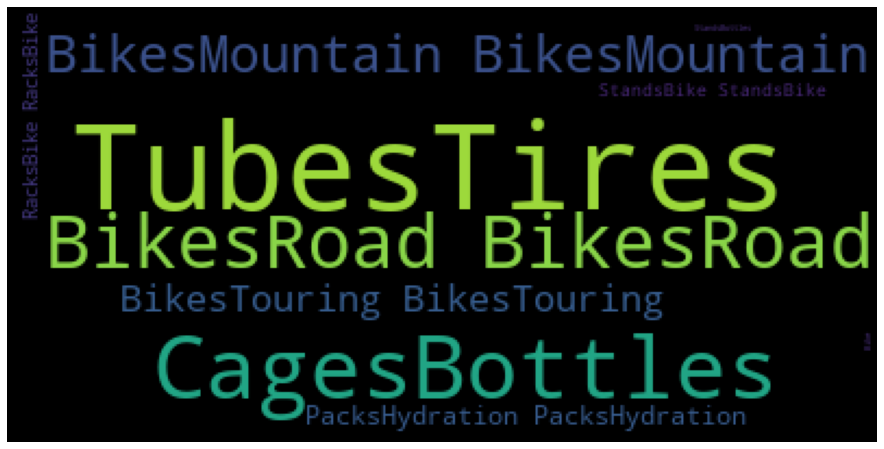

In [67]:
text1= ''.join(text['Sub_Category'])
wordcloud2 = WordCloud().generate(text1)
# Generate the plot
plt.figure(figsize=(20,8))
plt.imshow(wordcloud2)
plt.axis('off')
plt.show()

### Visualization of Frequency Distribution

In [68]:
def barplot(i):
    df=sales_df.groupby([i]).size().sort_values(ascending=False)
    fig=px.histogram(sales_df, x= sales_df[i],  template = 'plotly_dark',
                     title = f' Frequency of {i}', text_auto  = 'd3-format')
    fig.show()

In [69]:
barplot('Age_Group')
barplot('Customer_Gender')
barplot('Country')
barplot('State')
barplot('Product_Category')
barplot('Sub_Category')
barplot('Product')

Text(0.5, 1.0, 'Top 20 States by Frequency')

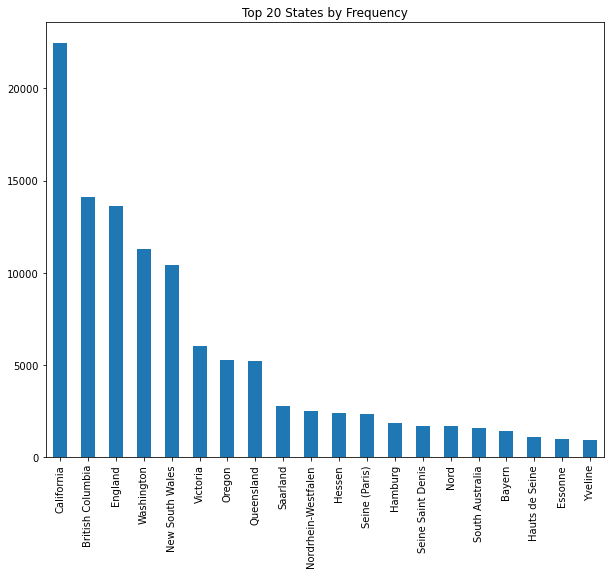

In [70]:
# check the top 20 states by Frequency
top_state =sales_df['State'].value_counts()[:20]
top_state.plot(kind='bar', figsize=(10,8))
plt.title('Top 20 States by Frequency')

Text(0.5, 1.0, 'Top 20 Products by Frequency')

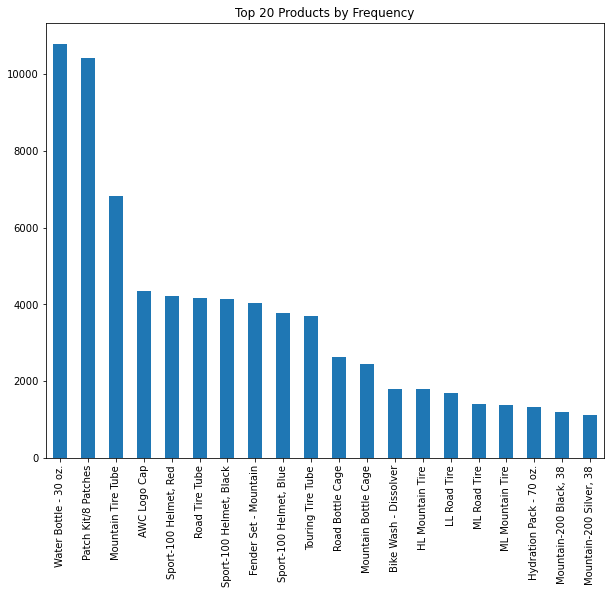

In [71]:
# check the top 20 Products
top_products =sales_df['Product'].value_counts()[:20]
top_products.plot(kind='bar', figsize=(10,8))
plt.title('Top 20 Products by Frequency')

### Conclusions
Since the data does not have the order_id and customer_id, it is impossible to ascertain if some of the orders are by the same customers or if they are all from unique customers. 

##### The conclusion below is based on the assumption that all orders are from unique customers. 

* Most of the company's customers are adults, between the ages of 35 and 64. This is followed by the adults group (between the ages of 25 and 34. It means the sales and marketing team should focus most of their marketing efforts at this groups since thats where majority of their customers are. Another way to look at it is that, the company needs to come up with a marketing strategy to attract the older population 64 and above (if they want to get more of this age demographic).
* Most of the company's customers are male. But then the number of female customers are not so far behind. 
* United states has the highest frequency of sale and Germany has the lowest. The reasons for this can then be further analyzed using more data from the company. 
* California stands out as the state with the highest frequency, followed by British Columbia. 
* Accessories are the most in demand product category
* Tires and tubes are the most in demand sub category
* Water Bottle 30 is the most in demand product. 

## Bivariate Analysis

### Checking Total sales by the different categorical variables

In [75]:
total_sale = pd.DataFrame(sales_df.groupby('Age_Group')['Sales'].sum().sort_values(ascending=True))
total_sale = total_sale.reset_index()
total_sale.columns = ['Age_Group', 'Total Sale']

fig=px.bar(total_sale, x='Total Sale', y = 'Age_Group', title='Total Sales by Age Group')
fig.show()

In [76]:
# Total Sales by State
total_sale = pd.DataFrame(sales_df.groupby('State')['Sales'].sum().sort_values(ascending=True))
total_sale = total_sale.reset_index()
total_sale.columns = ['State', 'Total Sale']

fig=px.bar(total_sale, x='Total Sale', y = 'State', title='Total Sales by State')
fig.show()

In [77]:
#Total Sales by Country
total_sale = pd.DataFrame(sales_df.groupby('Country')['Sales'].sum().sort_values(ascending=True))
total_sale = total_sale.reset_index()
total_sale.columns = ['Country', 'Total Sale']

fig=px.bar(total_sale, x='Total Sale', y = 'Country', title='Total Sales by Country')
fig.show()

In [78]:
# Total Sales by Sub_Category
total_sale = pd.DataFrame(sales_df.groupby('Sub_Category')['Sales'].sum().sort_values(ascending=True))
total_sale = total_sale.reset_index()
total_sale.columns = ['Sub_Category', 'Total Sale']

fig=px.bar(total_sale, x='Total Sale', y = 'Sub_Category', title='Total Sales by Sub_Category')
fig.show()

In [79]:
# Total Sales by Product Category
total_sale = pd.DataFrame(sales_df.groupby('Product_Category')['Sales'].sum().sort_values(ascending=True))
total_sale = total_sale.reset_index()
total_sale.columns = ['Product_Category', 'Total Sale']

fig=px.bar(total_sale, x='Total Sale', y = 'Product_Category', title='Total Sales by Product Category')
fig.show()

In [80]:
# Total Sales by Product (Top 20 Products)
total_sale = pd.DataFrame(sales_df.groupby('Product')['Sales'].sum()[:20].sort_values(ascending=True))

total_sale = total_sale.reset_index()
total_sale.columns = ['Product', 'Total Sale']

fig=px.bar(total_sale, x='Total Sale', y = 'Product', title='Total Sales by Product: Top 20 Products')
fig.show()

#### Conclusions

##### Using the total sales as the KPI, the follwowing observations were made:
* Adults (35 - 64) are the highest customer demographic in terms of age, followed by Young Adults (25 - 34). Seniors make the lowest customer demographic. 
* England and British Columbia have the highest sales. Alabama has the lowest sales.
* The United States of America, followed by Australia have the highest sale.
* Road Bikes and Mountain Bikes sub-category brought in the highest sales. 
* The highest selling product is the Fender set mountain bike. 

##### The sales and marketing team can use this information to improve their marketing strategies.

### Checking the Average Sales by different categorical attributes

In [81]:
avg_sale = pd.DataFrame(sales_df.groupby('Age_Group')['Sales'].mean().sort_values(ascending=False))
avg_sale = avg_sale.reset_index()
avg_sale.columns = ['Age_Group', 'Avg. Sale']

fig=px.bar(avg_sale, x='Avg. Sale', y = 'Age_Group', color='Age_Group', title='Average Sales by Age Group')
fig.show()

In [82]:
avg_sale = pd.DataFrame(sales_df.groupby('State')['Sales'].mean().sort_values(ascending=False))
avg_sale = avg_sale.reset_index()
avg_sale.columns = ['State', 'Avg. Sale']

fig=px.bar(avg_sale, x='Avg. Sale', y = 'State', color='State', title ='Average Sales by State')
fig.show()

In [83]:
avg_sale = pd.DataFrame(sales_df.groupby('Country')['Sales'].mean().sort_values(ascending=False))
avg_sale = avg_sale.reset_index()
avg_sale.columns = ['Country', 'Avg. Sale']

fig=px.bar(avg_sale, x='Avg. Sale', y = 'Country', color='Country', title ='Average Sales by Country')
fig.show()

In [84]:
avg_sale = pd.DataFrame(sales_df.groupby('Sub_Category')['Sales'].mean().sort_values(ascending=False))
avg_sale = avg_sale.reset_index()
avg_sale.columns = ['Sub_Category', 'Avg. Sale']

fig=px.bar(avg_sale, x='Avg. Sale', y = 'Sub_Category', color='Sub_Category', title= 'Average Sales by Sub-Category')
fig.show()

In [85]:
avg_sale = pd.DataFrame(sales_df.groupby('Product_Category')['Sales'].mean().sort_values(ascending=False))
avg_sale = avg_sale.reset_index()
avg_sale.columns = ['Product_Category', 'Avg. Sale']

fig=px.bar(avg_sale, x='Avg. Sale', y = 'Product_Category', color='Product_Category', title='Average Sales by Product Category')
fig.show()

### Conclusion
The following conclusions were observed when analyzing the different categorical variables by the average sales:
* The young adult age group bring in the most sales had a higher sales average than the Adults. Seniors are still the lowest. The company might then want to look into ways to continue attracting the young adult age group and then come up with more strategies to grow the seniors age group. They might also want to further look into why the senior demographics are so low. 
* Arizona state has the highest sales average. The company might want to look into what factors are contributing to Alabama's high sales average and then seeing if they can replicate some of these in the lower performing states like Alabama and Ontario.
* Australia has the higest performance, while Canada is performing the lowest.  
* Road bikes (products)  and Bikes (sub category) has the highest sales average. Using this data, the company can decide on ways to continue maintaining sales of their bike product, while devising strategies to improve the low performing products like the cleaners, and Bottles and Cages. They could also decide if they want to focus on only the higher performing products and reduce the quantity of lower performing products they offer in their stores. 

In all, knowing how their various products, countries and customer demographic are performing using the metric 'Average sales' would help the business tailor their sales and marketing strategy, and make data driven decisions. 

### Checking the Total Sales by Month and Year

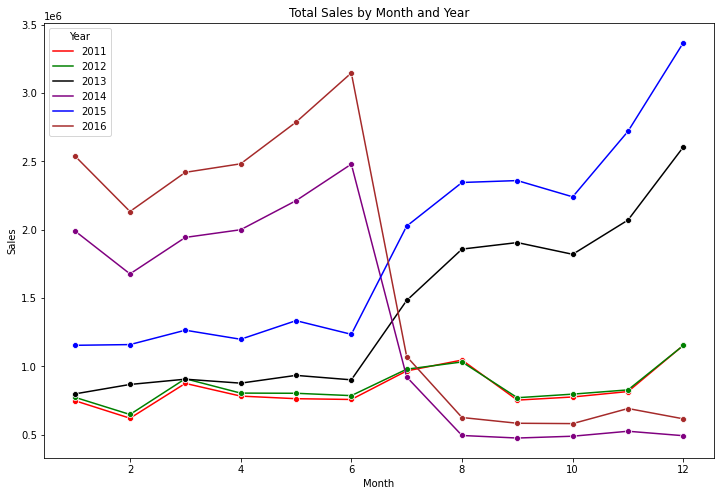

In [86]:
# Total Sales by Month and Year
plt.figure(figsize=(12,8))

monthly_sales = sales_df.groupby(['Year','Month'])['Sales'].sum().reset_index()
monthly_sales
sns.lineplot(x="Month", y="Sales",hue="Year", data=monthly_sales, marker='o', 
             palette=['red', 'green', 'black', 'purple', 'blue', 'brown'])
plt.xlabel('Month')
plt.ylabel('Sales')
plt.title('Total Sales by Month and Year')
plt.show()

### Conclusion

#### Comparing the total sales across the 6 years of data analysied, the following conclusions were drawn:
* 2014 and 2016 have a similar sales trend. Sales are higher in January and then it dips by Febraury. 
Then it starts to grow in March. By July, sales reach a peak and then has a downward trend all the way to December. This trend raises a lot of questions which would lead to further data gathering and analysis. 
> * Knowing that the company's highest sales come from bikes, could this  upward trend from March and peak in July be because of Summer? Do more people buy bikes in summer? 
> * Could the lower trend in August to December be because of the approaching winter months? 
> * What can the company then do to ensure they are still making sales between August and December? 
> * Would they want to focus on stronger marketing for their other product catergories during the colder months when less people purchase bikes? 

* 2015 and 2013 have similiar sales trend, which are the opposite of what was observed in 2014 and 2016. Sales are lower in the 1st half of the year and higher in the 2nd half. This is quite interesting and it leads to more questions. 
> * What changed? Are there seasonal factors?
> * Why is 2015 so different from 2016? 
> * What did the company do or not do in 2016 and 2014 that weren't done or were done in 2013 and 2015?
> * Why is the trend in 2013 and 2015 the opposite of the trend in 2014 and 2016? 


* 2011 and 2012 have a similar trend as well. 
> * Is there something in the company that gets done or not done every 2 years? 
> * Is there a review of processes? 
> * Why are there similar trends occuring?

#### Observing the monthly and yearly trends opens the door for further investigation and analysis.

### Checking the Average Sales by Month and Year.

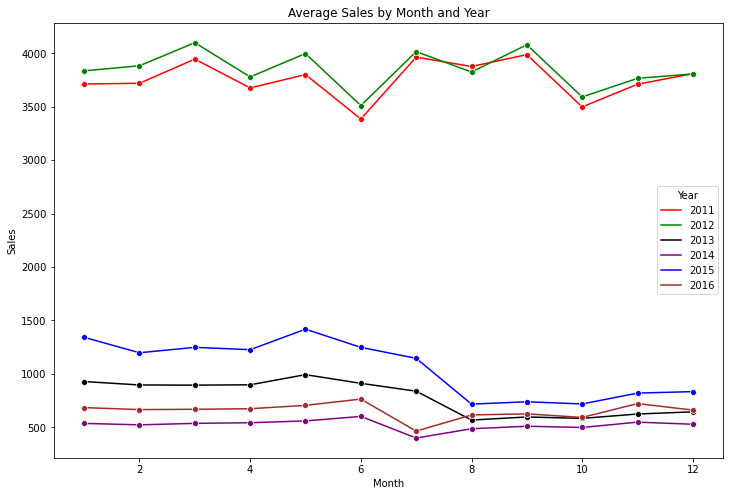

In [87]:
#Monthly Revenue
plt.figure(figsize=(12,8))

monthly_sales = sales_df.groupby(['Year','Month'])['Sales'].mean().reset_index()
monthly_sales
sns.lineplot(x="Month", y="Sales",hue="Year", data=monthly_sales, marker='o', 
             palette=['red', 'green', 'black', 'purple', 'blue', 'brown'])
plt.xlabel('Month')
plt.ylabel('Sales')
plt.title('Average Sales by Month and Year')
plt.show()

#### Conclusion
* There is a similar trend observed in 2013, 2014, 2015 and 2016. 
* The average sales are Start at high point in January and then dips in February, but starts to grow in April.
* Between May and June, the average sales reach a peak which plummets by August. 

This leads to more questions, for further investigation. 

* 2011 and 2012 have a similar trend. 

### Multivariate Analysis

## Tree Maps

### What was our profit in the different countries, and in what product categories?

In [88]:
px.treemap(sales_df, path = ['Country', 'Product_Category', 'Age_Group'], values='Profit')

### What was our cost in different countries and in the different categories?

#### Insights

* The United States is the most profitable of all the countries the company operates, followed by Autrialia. Canada is the least profitable country. 
* The product category with the highest profit in the United states and across all the other countries is Bikes, followed by accessories and lastly clothing
* In all countries, Adults age group formed the most profitable demographic, except for France where the Young Adult age group led the Adults age group by almost $200,000 



In [89]:
px.treemap(sales_df, path = ['Country', 'Product_Category'], values='Cost')

#### Insights
* The United States had the highest cost, followed by Australia and Canada had the lowest.
* Bikes also has the highest cost, followed by accessories and clothing last in all countries the company operates. 

### Estimating Correlation coefficients

In [90]:
correlation_df =sales_df.corr()

In [91]:
correlation_df['Sales'].sort_values(ascending=False)

Sales             1.000000
Cost              0.993769
Profit            0.986170
Unit_Price        0.821468
Unit_Cost         0.820789
Day               0.002043
Month            -0.000075
Customer_Age     -0.012505
Year             -0.209921
Order_Quantity   -0.314561
Name: Sales, dtype: float64

## Heat Maps

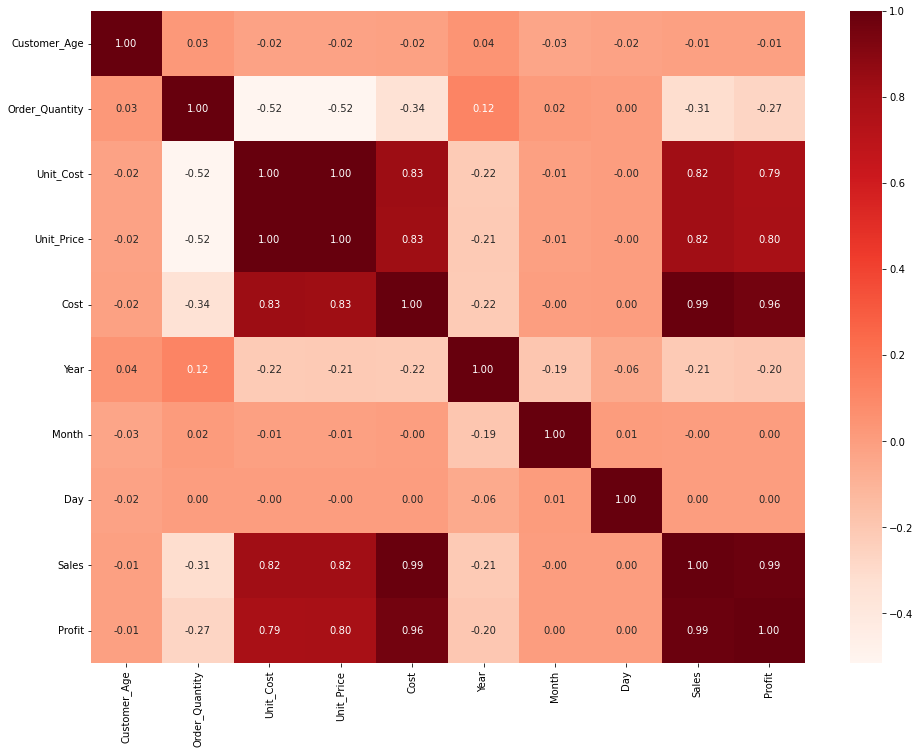

In [92]:
# Creating a heatmap
plt.figure(figsize=(16, 12))
sns.heatmap(sales_df.corr(), cmap='Reds', annot=True, fmt='.2f');

### Interpretation

There is a positive correlation between sales and cost


A high correlation shows a strong relationship between 2 variables and a low correlation means a weak relation. 

Correlation coefficient ranges between -1 and +1. A positive correlation between 2 variables means that both variables move in the same direction, that is, an increase in one variable leads to an increase in another. 
